# Data Engineering Analysis

In [1]:
import os
import pandas as pd
import numpy as np
from sklearn.pipeline import Pipeline
import data_engineering
from sklearn.preprocessing import FunctionTransformer
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
# data path
data_path = "../data"

In [3]:
df_train = pd.read_csv(os.path.join(data_path, "train.csv"))
df_train.head()

,Id,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,...,Soil_Type32,Soil_Type33,Soil_Type34,Soil_Type35,Soil_Type36,Soil_Type37,Soil_Type38,Soil_Type39,Soil_Type40,Cover_Type
0,242642,2881,130,22,210,54,1020,250,221,88,...,0,0,0,0,0,0,0,0,0,1
1,309891,3005,351,14,242,-16,1371,194,215,159,...,0,0,0,0,0,0,0,0,0,1
2,287847,3226,63,14,618,2,1092,232,210,107,...,0,0,0,0,0,0,0,0,0,1
3,516307,3298,317,8,661,60,752,198,233,174,...,0,0,0,0,0,0,0,0,0,1
4,124860,3080,35,6,175,26,3705,219,227,144,...,0,0,0,0,0,0,0,0,0,1


In [4]:
transformations = [
    ("euclidean_dist", FunctionTransformer(data_engineering.euclidean_dist)),
    ("linear_dist", FunctionTransformer(data_engineering.linear_dist)),
    ("mean_hillshade", FunctionTransformer(data_engineering.mean_hillshade)),
    ("morning_hillshade", FunctionTransformer(data_engineering.morning_hillshade)),
    ("mean_amenties", FunctionTransformer(data_engineering.mean_amenties)),
    ("aspect_dir", FunctionTransformer(data_engineering.aspect_dir)),
    ("climatic_zone", FunctionTransformer(data_engineering.climatic_zone)),
    ("geologic_zone", FunctionTransformer(data_engineering.geologic_zone)),
    ("soil_type", FunctionTransformer(data_engineering.soil_type)),
    # ("scaling", FunctionTransformer(data_engineering.scaling)),
]

pipe = Pipeline(transformations)

In [5]:
pipe

Pipeline(steps=[('euclidean_dist',
                 FunctionTransformer(func=<function euclidean_dist at 0x7fb160c65af0>)),
                ('linear_dist',
                 FunctionTransformer(func=<function linear_dist at 0x7fb160c65b80>)),
                ('mean_hillshade',
                 FunctionTransformer(func=<function mean_hillshade at 0x7fb160c65c10>)),
                ('morning_hillshade',
                 FunctionTransformer(func=<function morning_hillshade at 0x7fb160...
                 FunctionTransformer(func=<function mean_amenties at 0x7fb160c65d30>)),
                ('aspect_dir',
                 FunctionTransformer(func=<function aspect_dir at 0x7fb160c65dc0>)),
                ('climatic_zone',
                 FunctionTransformer(func=<function climatic_zone at 0x7fb160c65e50>)),
                ('geologic_zone',
                 FunctionTransformer(func=<function geologic_zone at 0x7fb160c65ee0>)),
                ('soil_type',
                 FunctionTransformer(func=<function soil_type at 0x7fb160c65f70>))])

In [6]:
df_final = pipe.fit_transform(df_train)

In [7]:
df_final

,Id,Elevation,Aspect,Distance_To_Hydrology,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,...,Clim6,Clim7,Clim8,Geo1,Geo2,Geo5,Geo7,Soil_Stony,Soil_Rubly,Soil_Other
0,242642,2881,130,216.8317,22,210,54,1020,250,221,...,0,1,0,0,0,0,1,1,0,0
1,309891,3005,351,242.5283,14,242,-16,1371,194,215,...,0,1,0,0,0,0,1,1,0,0
2,287847,3226,63,618.0032,14,618,2,1092,232,210,...,0,1,0,0,0,0,1,1,0,0
3,516307,3298,317,663.7176,8,661,60,752,198,233,...,0,1,0,0,1,0,0,0,0,1
4,124860,3080,35,176.9209,6,175,26,3705,219,227,...,0,1,0,0,0,0,1,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15115,475155,3328,321,323.2228,13,323,12,5109,186,227,...,0,0,1,0,0,0,1,1,0,0
15116,514378,3455,37,846.0171,5,841,92,939,220,229,...,0,0,1,0,0,0,1,0,0,0
15117,368425,3279,90,419.5057,14,404,113,1513,240,218,...,0,1,0,0,0,0,1,1,0,0
15118,537844,3589,357,421.2220,9,418,52,1868,205,223,...,0,0,1,0,0,0,1,0,0,0


In [8]:
print(df_final.columns)

Index(['Id', 'Elevation', 'Aspect', 'Distance_To_Hydrology', 'Slope',
       'Horizontal_Distance_To_Hydrology', 'Vertical_Distance_To_Hydrology',
       'Horizontal_Distance_To_Roadways', 'Hillshade_9am', 'Hillshade_Noon',
       'Hillshade_3pm', 'Horizontal_Distance_To_Fire_Points',
       'Wilderness_Area1', 'Wilderness_Area2', 'Wilderness_Area3',
       'Wilderness_Area4', 'Soil_Type1', 'Soil_Type2', 'Soil_Type3',
       'Soil_Type4', 'Soil_Type5', 'Soil_Type6', 'Soil_Type7', 'Soil_Type8',
       'Soil_Type9', 'Soil_Type10', 'Soil_Type11', 'Soil_Type12',
       'Soil_Type13', 'Soil_Type14', 'Soil_Type15', 'Soil_Type16',
       'Soil_Type17', 'Soil_Type18', 'Soil_Type19', 'Soil_Type20',
       'Soil_Type21', 'Soil_Type22', 'Soil_Type23', 'Soil_Type24',
       'Soil_Type25', 'Soil_Type26', 'Soil_Type27', 'Soil_Type28',
       'Soil_Type29', 'Soil_Type30', 'Soil_Type31', 'Soil_Type32',
       'Soil_Type33', 'Soil_Type34', 'Soil_Type35', 'Soil_Type36',
       'Soil_Type37', 'Soil_Type3

In [9]:
print(df_final.dtypes)

Id                         int64
Elevation                  int64
Aspect                     int64
Distance_To_Hydrology    float64
Slope                      int64
                          ...   
Geo5                       int64
Geo7                       int64
Soil_Stony                 int64
Soil_Rubly                 int64
Soil_Other                 int64
Length: 84, dtype: object


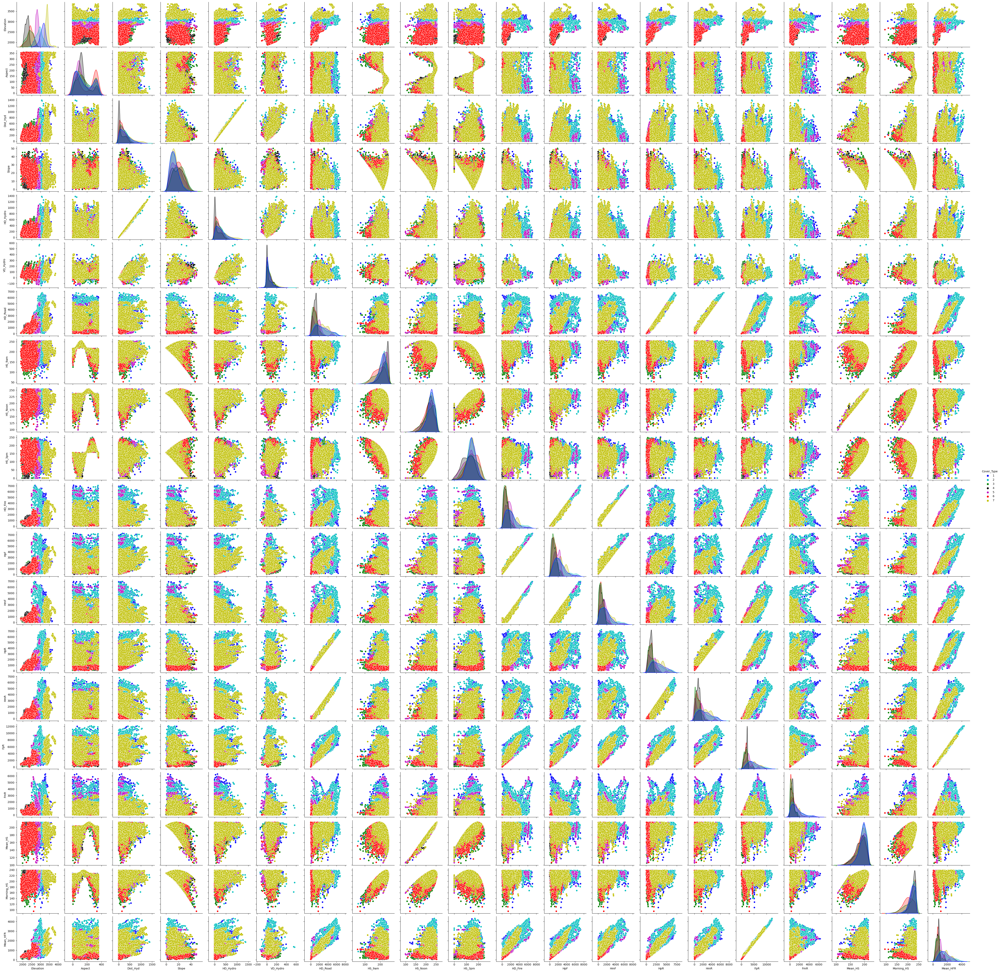

In [10]:
custom_palette = ["b", "c", "g", "k", "m", "r", "y"]
features = [
    "Elevation",
    "Aspect",
    "Distance_To_Hydrology",
    "Slope",
    "Horizontal_Distance_To_Hydrology",
    "Vertical_Distance_To_Hydrology",
    "Horizontal_Distance_To_Roadways",
    "Hillshade_9am",
    "Hillshade_Noon",
    "Hillshade_3pm",
    "Horizontal_Distance_To_Fire_Points",
    "Hyd_p_Fire",
    "Hyd_m_Fire",
    "Hyd_p_Road",
    "Hyd_m_Road",
    "Fire_p_Road",
    "Fire_m_Road",
    "Mean_Hillshade",
    "Morning_Hillshade",
    "Mean_Amenities",
    "Cover_Type",
]
labels = [
    "Elevation",
    "Aspect",
    "Dist_Hyd",
    "Slope",
    "HD_Hydro",
    "VD_Hydro",
    "HD_Road",
    "HS_9am",
    "HS_Noon",
    "HS_3pm",
    "HD_Fire",
    "HpF",
    "HmF",
    "HpR",
    "HmR",
    "FpR",
    "FmR",
    "Mean_HS",
    "Morning_HS",
    "Mean_HFR",
    "Cover_Type",
]

shorter_labels = dict(zip(features, labels))

corr_train = df_final[features].copy()
corr_train.rename(columns=shorter_labels, inplace=True)
axes = sns.pairplot(corr_train, hue="Cover_Type", palette=custom_palette)

In [11]:
# Highly Correlated Values
df_corr = corr_train.corr()
threshold = 0.5

corr_list = []
for i in range(0, 10):
    for j in range(i + 1, 10):
        if (df_corr.iloc[i, j] >= threshold and df_corr.iloc[i, j] < 1) or (
            df_corr.iloc[i, j] < 0 and df_corr.iloc[i, j] <= -threshold
        ):
            corr_list.append([df_corr.iloc[i, j], i, j])

corr_list = sorted(corr_list, key=lambda x: -abs(x[0]))

for k, i, j in corr_list:
    print("%s and %s = %.2f" % (labels[i], labels[j], k))

Dist_Hyd and HD_Hydro = 1.00
HS_9am and HS_3pm = -0.78
Dist_Hyd and VD_Hydro = 0.69
HD_Hydro and VD_Hydro = 0.65
Aspect and HS_3pm = 0.62
Slope and HS_Noon = -0.61
HS_Noon and HS_3pm = 0.61
Aspect and HS_9am = -0.59
Elevation and HD_Road = 0.58


# Soil Type Grouping

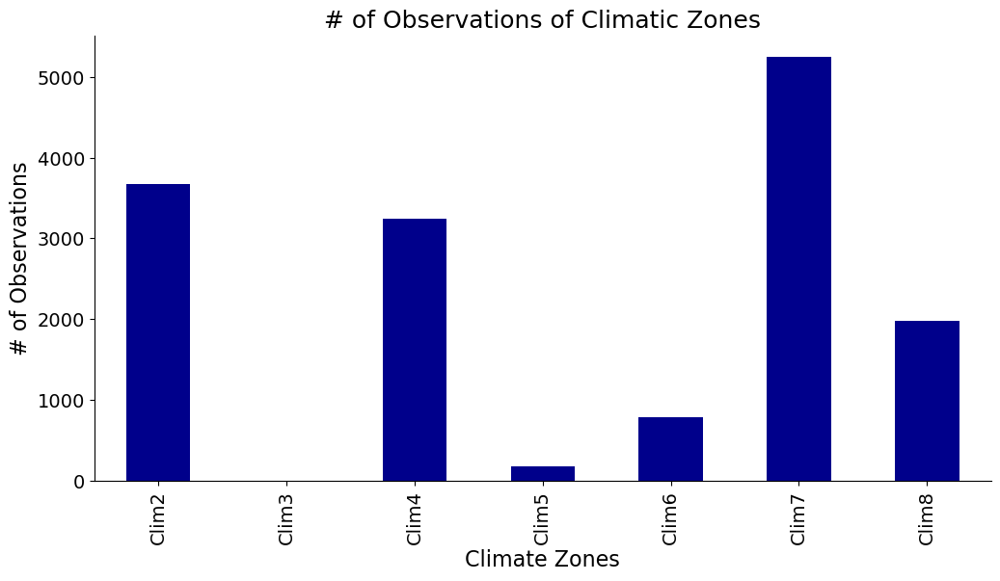

In [12]:
climatic_data = df_final[
    ["Clim2", "Clim3", "Clim4", "Clim5", "Clim6", "Clim7", "Clim8"]
]
climatic_data.sum().plot(kind="bar", figsize=(12, 6), color="darkblue")
plt.title("# of Observations of Climatic Zones", size=18)
plt.xlabel("Climate Zones", size=16)
plt.ylabel("# of Observations", size=16)
plt.xticks(rotation=90, size=14)
plt.yticks(size=14)

sns.despine()
plt.show()

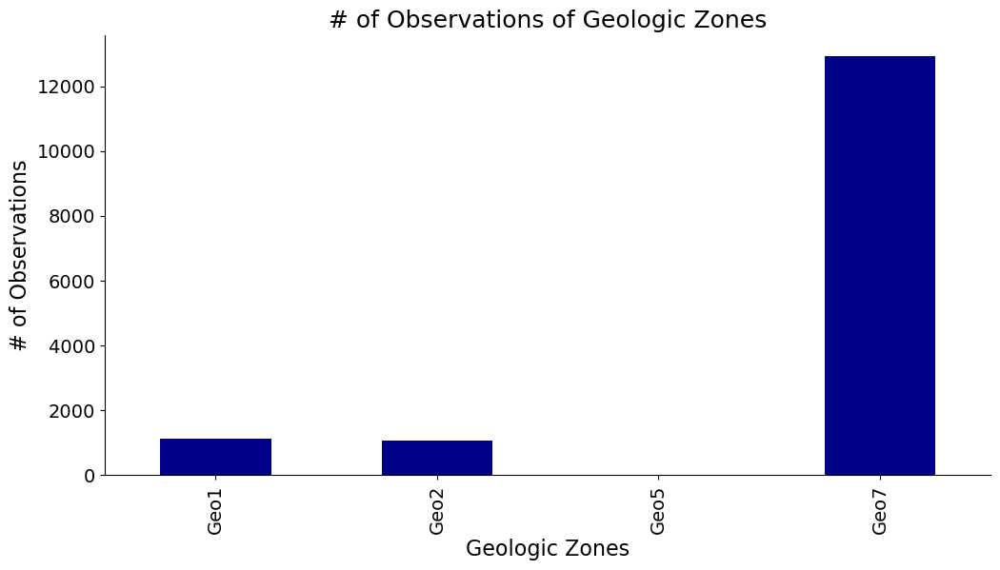

In [13]:
geologic_data = df_final[["Geo1", "Geo2", "Geo5", "Geo7"]]
geologic_data.sum().plot(kind="bar", figsize=(12, 6), color="darkblue")
plt.title("# of Observations of Geologic Zones", size=18)
plt.xlabel("Geologic Zones", size=16)
plt.ylabel("# of Observations", size=16)
plt.xticks(rotation=90, size=14)
plt.yticks(size=14)

sns.despine()
plt.show()

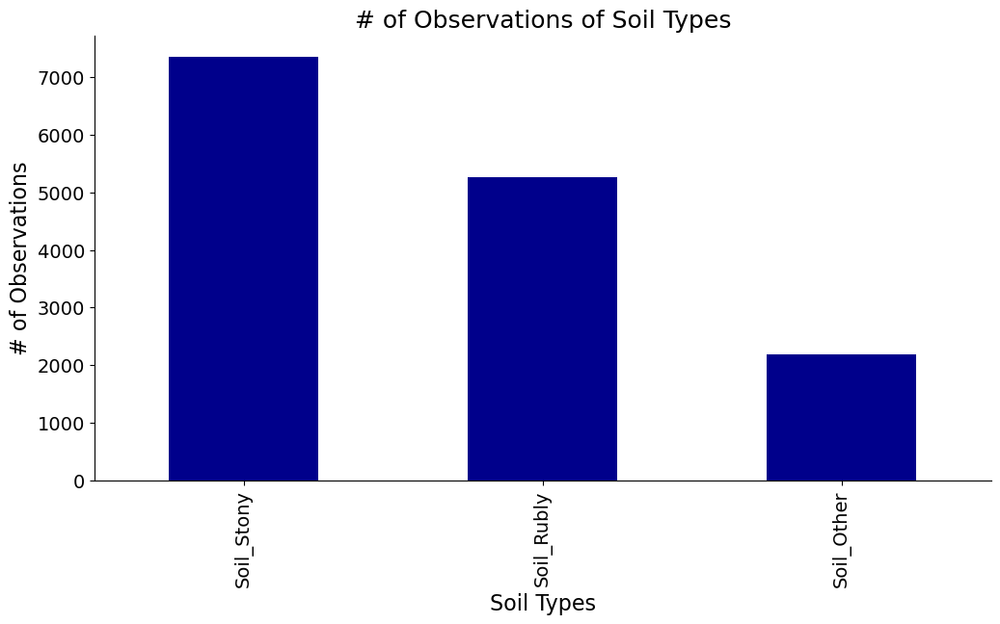

In [14]:
soil_data = df_final[["Soil_Stony", "Soil_Rubly", "Soil_Other"]]
soil_data.sum().plot(kind="bar", figsize=(12, 6), color="darkblue")
plt.title("# of Observations of Soil Types", size=18)
plt.xlabel("Soil Types", size=16)
plt.ylabel("# of Observations", size=16)
plt.xticks(rotation=90, size=14)
plt.yticks(size=14)

sns.despine()
plt.show()

# Hillshade - Apsect

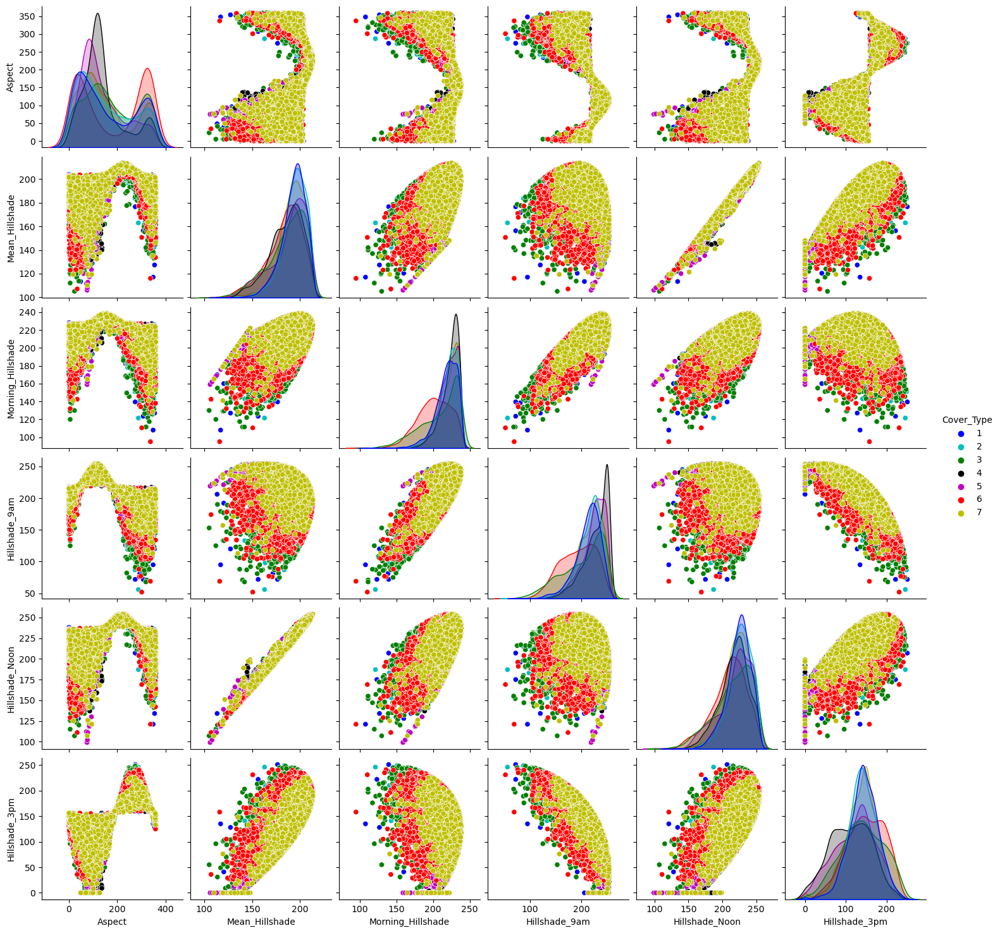

In [15]:
sns.pairplot(
    df_final[
        [
            "Aspect",
            "Mean_Hillshade",
            "Morning_Hillshade",
            "Hillshade_9am",
            "Hillshade_Noon",
            "Hillshade_3pm",
            "Cover_Type",
        ]
    ],
    hue="Cover_Type",
    palette=custom_palette,
)
plt.show()

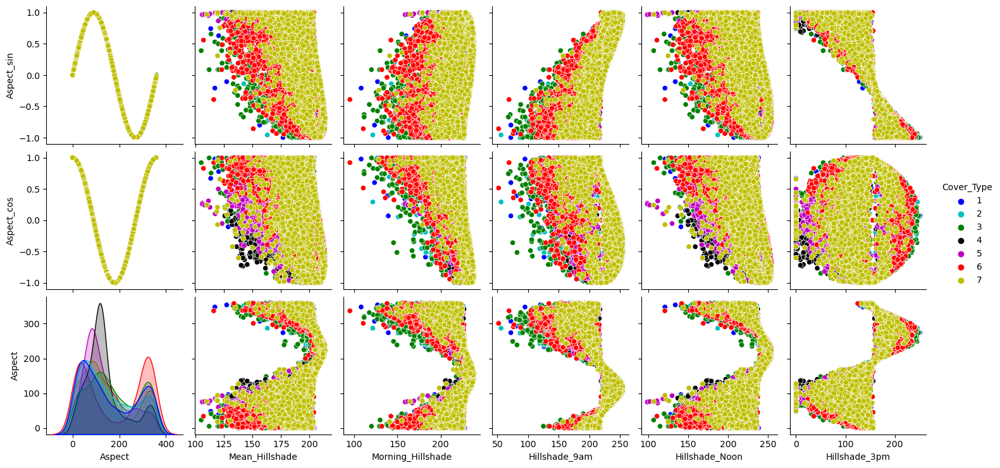

In [16]:
df_final["Aspect_sin"] = np.sin(2 * np.pi * df_final["Aspect"] / 360)
df_final["Aspect_cos"] = np.cos(2 * np.pi * df_final["Aspect"] / 360)
sns.pairplot(
    df_final,
    x_vars=[
        "Aspect",
        "Mean_Hillshade",
        "Morning_Hillshade",
        "Hillshade_9am",
        "Hillshade_Noon",
        "Hillshade_3pm",
    ],
    y_vars=["Aspect_sin", "Aspect_cos", "Aspect"],
    hue="Cover_Type",
    palette=custom_palette,
)
plt.show()

In [17]:
correlation = df_final.corr()
aspect_correlation = correlation["Aspect"].sort_values()
abs_correlation = aspect_correlation.abs()
sorted_correlation = abs_correlation.sort_values(ascending=False)
print(sorted_correlation.head(10))

Aspect               1.000000
Aspect_sin           0.760200
Hillshade_3pm        0.624801
Hillshade_9am        0.590290
Aspect_E             0.465743
Aspect_W             0.449241
Mean_Hillshade       0.345883
Hillshade_Noon       0.313553
Morning_Hillshade    0.287658
Wilderness_Area1     0.148501
Name: Aspect, dtype: float64


In [18]:
aspect_sin_correlation = correlation["Aspect_sin"].sort_values()
abs_correlation = aspect_sin_correlation.abs()
sorted_correlation = abs_correlation.sort_values(ascending=False)
print(sorted_correlation.head(10))

Aspect_sin           1.000000
Hillshade_3pm        0.849464
Hillshade_9am        0.802688
Aspect_E             0.761513
Aspect               0.760200
Aspect_W             0.681844
Mean_Hillshade       0.457635
Morning_Hillshade    0.408217
Hillshade_Noon       0.397930
Aspect_N             0.220680
Name: Aspect_sin, dtype: float64


In [19]:
aspect_cos_correlation = correlation["Aspect_cos"].sort_values()
abs_correlation = aspect_cos_correlation.abs()
sorted_correlation = abs_correlation.sort_values(ascending=False)
print(sorted_correlation.head(10))

Aspect_cos           1.000000
Aspect_N             0.742288
Aspect_S             0.699339
Morning_Hillshade    0.645951
Hillshade_Noon       0.493358
Hillshade_9am        0.434529
Mean_Hillshade       0.358618
Soil_Type10          0.302379
Clim2                0.295802
Clim4                0.232792
Name: Aspect_cos, dtype: float64


In [20]:
print(
    aspect_correlation["Hillshade_9am"],
    aspect_sin_correlation["Hillshade_9am"],
    aspect_cos_correlation["Hillshade_9am"],
)

-0.5902897395198095 0.8026877949385635 -0.4345293132450801


# Correlation with target

In [21]:
corr_train["Aspect_sin"] = df_final["Aspect_sin"]
corr_train["Aspect_cos"] = df_final["Aspect_cos"]
correlation = corr_train.corr()
target_correlation = correlation["Cover_Type"].sort_values()
abs_correlation = target_correlation.abs()
sorted_correlation = abs_correlation.sort_values(ascending=False)
print(sorted_correlation)

Cover_Type    1.000000
FmR           0.217076
FpR           0.128087
Mean_HFR      0.125420
HmR           0.122400
HD_Road       0.119576
HpR           0.115382
HD_Fire       0.099413
HmF           0.098654
HpF           0.095952
HS_Noon       0.093008
Mean_HS       0.092634
Slope         0.086536
VD_Hydro      0.070615
Morning_HS    0.068312
HS_3pm        0.047372
Aspect_cos    0.026576
HS_9am        0.015570
Elevation     0.014241
Aspect_sin    0.012245
Aspect        0.009439
HD_Hydro      0.004266
Dist_Hyd      0.000025
Name: Cover_Type, dtype: float64


## Elevation Aggregation Analysis

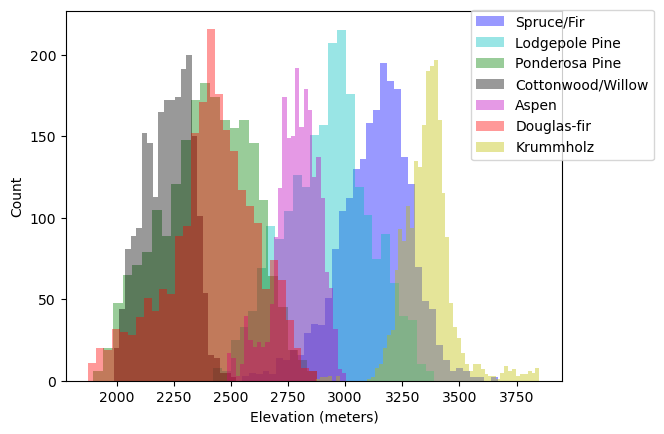

In [22]:
# Plot an Elevation's histogram for each Cover Type to check for class separation
elevations = df_train.loc[:, ["Elevation", "Cover_Type"]]

# Dictionary for mapping each integer target label to its string value
covtype_label_name_dict = {
    1: "Spruce/Fir",
    2: "Lodgepole Pine",
    3: "Ponderosa Pine",
    4: "Cottonwood/Willow",
    5: "Aspen",
    6: "Douglas-fir",
    7: "Krummholz",
}

custom_palette = ["b", "c", "g", "k", "m", "r", "y"]


# Iterate through the dictionary to plot a histogram for each cover type
for covtype_id, covtype_name in covtype_label_name_dict.items():
    palette_idx = covtype_id - 1
    by_one_covtype = elevations.groupby("Cover_Type").apply(
        lambda x: x[x["Cover_Type"] == covtype_id]
    )
    ax = sns.histplot(
        by_one_covtype.Elevation,
        color=custom_palette[palette_idx],
        label=covtype_name,
        kde=False,
        alpha=0.4,
        linewidth=0,
    )

plt.legend(loc="right", bbox_to_anchor=(1.2, 0.8))
ax.set(xlabel="Elevation (meters)", ylabel="Count")
plt.show()


In [29]:
el_means = elevations.groupby("Cover_Type").mean()
print(el_means)

              Elevation
Cover_Type             
1           3129.958333
2           2922.785185
3           2393.389815
4           2224.697222
5           2789.718056
6           2417.350000
7           3362.650926


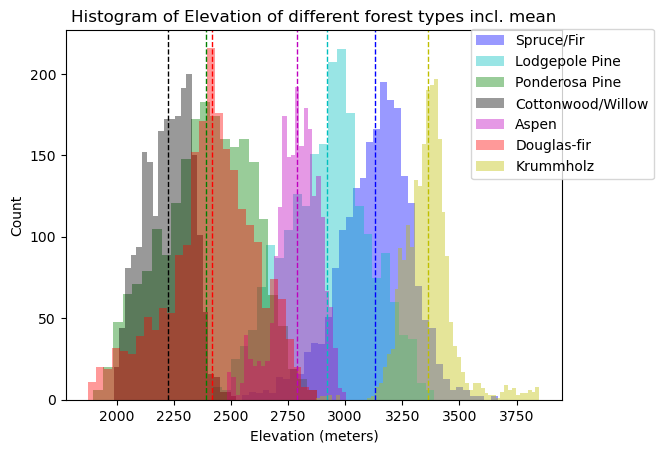

In [30]:
# Iterate through the dictionary to plot a histogram for each cover type
for covtype_id, covtype_name in covtype_label_name_dict.items():
    palette_idx = covtype_id - 1
    by_one_covtype = elevations.groupby("Cover_Type").apply(
        lambda x: x[x["Cover_Type"] == covtype_id]
    )
    ax = sns.histplot(
        by_one_covtype.Elevation,
        color=custom_palette[palette_idx],
        label=covtype_name,
        kde=False,
        alpha=0.4,
        linewidth=0,
    )
    plt.axvline(el_means.loc[covtype_id].item(), color=custom_palette[palette_idx], linestyle='dashed', linewidth=1)

plt.legend(loc="right", bbox_to_anchor=(1.2, 0.8))
ax.set(xlabel="Elevation (meters)", ylabel="Count")
plt.title("Histogram of Elevation of different forest types incl. mean")
plt.show();

In [31]:
el_medians = elevations.groupby("Cover_Type").median()
print(el_medians)

            Elevation
Cover_Type           
1              3146.0
2              2937.5
3              2404.5
4              2232.0
5              2797.0
6              2424.5
7              3362.0


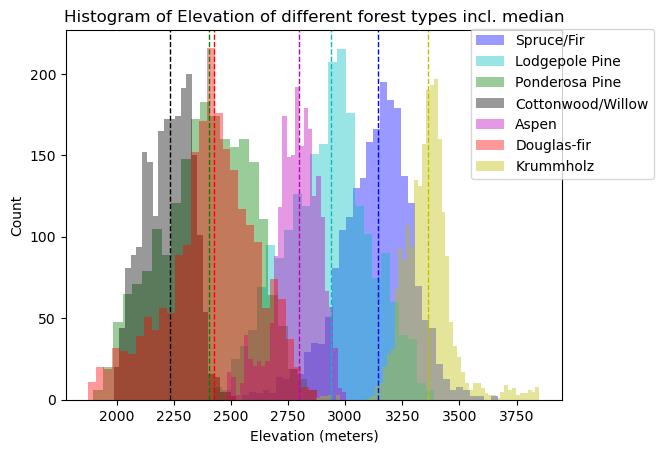

In [32]:
# Iterate through the dictionary to plot a histogram for each cover type
for covtype_id, covtype_name in covtype_label_name_dict.items():
    palette_idx = covtype_id - 1
    by_one_covtype = elevations.groupby("Cover_Type").apply(
        lambda x: x[x["Cover_Type"] == covtype_id]
    )
    ax = sns.histplot(
        by_one_covtype.Elevation,
        color=custom_palette[palette_idx],
        label=covtype_name,
        kde=False,
        alpha=0.4,
        linewidth=0,
    )
    plt.axvline(el_medians.loc[covtype_id].item(), color=custom_palette[palette_idx],  linestyle='dashed', linewidth=1)

plt.legend(loc="right", bbox_to_anchor=(1.2, 0.8))
ax.set(xlabel="Elevation (meters)", ylabel="Count")
plt.title("Histogram of Elevation of different forest types incl. median")
plt.show();

In [10]:
cols = ["Wilderness_Area1", "Wilderness_Area2", "Wilderness_Area3", "Wilderness_Area4"]
mel = df_train[cols].melt(ignore_index=False)
mel = mel.loc[mel.value == 1, "variable"]
df_train = pd.merge(df_train, mel, left_index=True, right_index=True)
print(df_train.groupby('variable')['Elevation'].mean())
df_train.drop(columns=["variable"], inplace=True)

variable
Wilderness_Area1    3000.780269
Wilderness_Area2    3325.254833
Wilderness_Area3    2917.680578
Wilderness_Area4    2258.814356
Name: Elevation, dtype: float64


In [11]:
cols = list(df_train.columns[df_train.columns.str.contains("^Soil_Type[0-9][0-9]$|^Soil_Type[0-9]$")])
mel = df_train[cols].melt(ignore_index=False)
mel = mel.loc[mel.value == 1, "variable"]
df_train = pd.merge(df_train, mel, left_index=True, right_index=True)
print(df_train.groupby('variable')['Elevation'].mean())
df_train.drop(columns=["variable"], inplace=True)

variable
Soil_Type1     2168.731563
Soil_Type10    2376.131679
Soil_Type11    2649.273936
Soil_Type12    2817.557692
Soil_Type13    2841.742690
Soil_Type14    2210.023121
Soil_Type16    2410.735849
Soil_Type17    2364.798438
Soil_Type18    2523.090909
Soil_Type19    3031.037736
Soil_Type2     2461.157895
Soil_Type20    2766.272727
Soil_Type21    3079.900000
Soil_Type22    3153.177711
Soil_Type23    3046.247978
Soil_Type24    3040.550943
Soil_Type25    3243.500000
Soil_Type26    2874.083333
Soil_Type27    3272.875000
Soil_Type28    2743.714286
Soil_Type29    2981.273700
Soil_Type3     2260.276342
Soil_Type30    2839.506793
Soil_Type31    3026.934211
Soil_Type32    3087.978884
Soil_Type33    2993.605816
Soil_Type34    3081.777778
Soil_Type35    3350.019417
Soil_Type36    3390.214286
Soil_Type37    3402.531250
Soil_Type38    3348.489247
Soil_Type39    3332.037855
Soil_Type4     2539.525626
Soil_Type40    3474.541667
Soil_Type5     2172.127072
Soil_Type6     2368.172312
Soil_Type7     2909

In [12]:
df_train.Elevation.mean()

2748.649933862434